<a href="https://colab.research.google.com/github/Bashinim/Parking-Lot-Detection/blob/main/Detectron2/COWC_Instance_Segmentation_Detectron2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Instance Segmentation with COWC dataset. The annotations are in COCO format


In [1]:
from google.colab import drive
drive.mount('/content/drive/')

Drive already mounted at /content/drive/; to attempt to forcibly remount, call drive.mount("/content/drive/", force_remount=True).


In [2]:
# install dependencies: (use cu101 because colab has CUDA 10.1)
!pip install -U torch==1.5 torchvision==0.6 -f https://download.pytorch.org/whl/cu101/torch_stable.html 
!pip install cython pyyaml==5.1
!pip install -U 'git+https://github.com/cocodataset/cocoapi.git#subdirectory=PythonAPI'
import torch, torchvision
print(torch.__version__, torch.cuda.is_available())
!gcc --version
# opencv is pre-installed on colab

Looking in links: https://download.pytorch.org/whl/cu101/torch_stable.html
Requirement already up-to-date: torch==1.5 in /usr/local/lib/python3.7/dist-packages (1.5.0+cu101)
Requirement already up-to-date: torchvision==0.6 in /usr/local/lib/python3.7/dist-packages (0.6.0+cu101)
  Cloning https://github.com/cocodataset/cocoapi.git to /tmp/pip-req-build-8hpxfvsp
  Running command git clone -q https://github.com/cocodataset/cocoapi.git /tmp/pip-req-build-8hpxfvsp
  Created wheel for pycocotools: filename=pycocotools-2.0-cp37-cp37m-linux_x86_64.whl size=263918 sha256=842984efb0a191f89e6b44b679dee0db239edc93c2ae4add7432c366af486ff7
  Stored in directory: /tmp/pip-ephem-wheel-cache-xvc53zqx/wheels/90/51/41/646daf401c3bc408ff10de34ec76587a9b3ebfac8d21ca5c3a
Successfully built pycocotools
  Found existing installation: pycocotools 2.0
    Uninstalling pycocotools-2.0:
      Successfully uninstalled pycocotools-2.0
1.5.0+cu101 True
gcc (Ubuntu 7.5.0-3ubuntu1~18.04) 7.5.0
Copyright (C) 2017 Free

In [3]:
# install detectron2: (Colab has CUDA 10.1 + torch 1.8)
# See https://detectron2.readthedocs.io/tutorials/install.html for instructions
#import torch
#assert torch.__version__.startswith("1.8")   # need to manually install torch 1.8 if Colab changes its default version
!pip install detectron2==0.1.3 -f https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.5/index.html
# exit(0)  # After installation, you need to "restart runtime" in Colab. This line can also restart runtime

Looking in links: https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.5/index.html


## Get data

In [4]:
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import cv2
import random
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog
from detectron2.data.catalog import DatasetCatalog

Importing data

In [5]:
from detectron2.data.datasets import register_coco_instances
register_coco_instances("my_dataset_train", {}, "/content/drive/MyDrive/Cowc for detectrone2 test/Train_annotations.json", "/content/drive/MyDrive/Cowc for detectrone2 test/train")
#register_coco_instances("my_dataset_valid", {}, "/content/drive/MyDrive/COWC in COCO format/valid/annotations_valid.json", "/content/drive/MyDrive/COWC in COCO format/valid")
register_coco_instances("my_dataset_test", {}, "/content/drive/MyDrive/Cowc for detectrone2 test/Test_annotations.json", "/content/drive/MyDrive/Cowc for detectrone2 test/test")

## Register data-set

In order to use a dataset with Detectron2 we need to register it. For more information check out the official documentation.

WARNING [06/21 22:37:10 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[06/21 22:37:10 d2.data.datasets.coco]: Loaded 71 images in COCO format from /content/drive/MyDrive/Cowc for detectrone2 test/Train_annotations.json


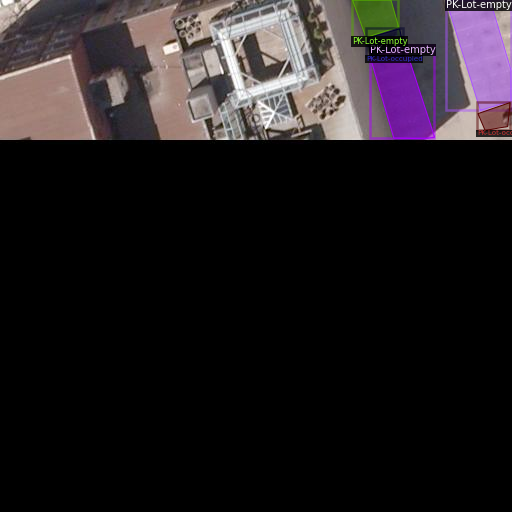

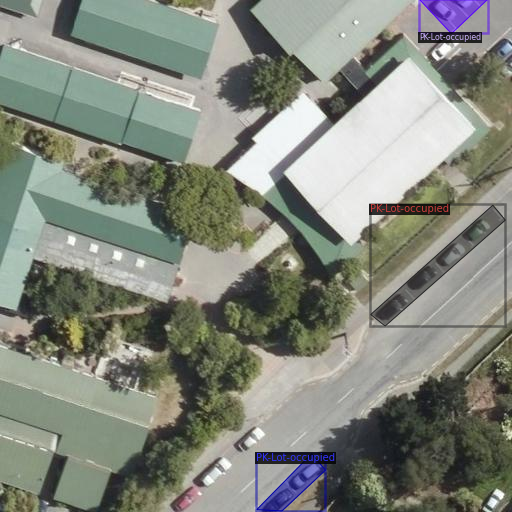

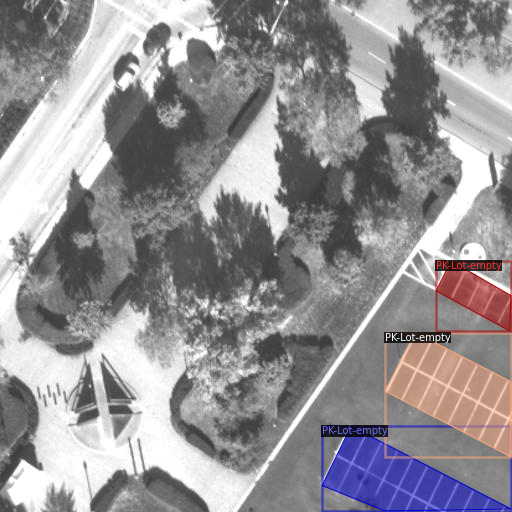

In [6]:
#visualize training data
my_dataset_train_metadata = MetadataCatalog.get("my_dataset_train")
dataset_dicts = DatasetCatalog.get("my_dataset_train")

import random
from detectron2.utils.visualizer import Visualizer

for d in random.sample(dataset_dicts, 3):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=my_dataset_train_metadata, scale=1)
    vis = visualizer.draw_dataset_dict(d)
    cv2_imshow(vis.get_image()[:, :, ::-1])

## Train model

Now, let's fine-tune a pretrained FasterRCNN instance segmentation model on the microcontroller data-set.

In [7]:
%%javascript
function ClickConnect(){
console.log("Working");
document.querySelector("colab-toolbar-button#connect").click()
}setInterval(ClickConnect,60000)

<IPython.core.display.Javascript object>

In [8]:
from detectron2.engine import DefaultTrainer
from detectron2.config import get_cfg
import os

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("my_dataset_train",)
cfg.DATASETS.TEST = ()
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.0025
cfg.SOLVER.MAX_ITER = 700
cfg.SOLVER.STEPS = []        # do not decay learning rate
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 4

os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg) 
trainer.resume_or_load(resume=False)
trainer.train()


[06/21 22:37:14 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

Skip loading parameter 'roi_heads.box_predictor.cls_score.weight' to the model due to incompatible shapes: (81, 1024) in the checkpoint but (5, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.cls_score.bias' to the model due to incompatible shapes: (81,) in the checkpoint but (5,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.weight' to the model due to incompatible shapes: (320, 1024) in the checkpoint but (16, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.bias' to the model due to incompatible shapes: (320,) in the checkpoint but (16,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.mask_head.predictor.weight' to the model due to incompatible shapes: (80, 256, 1, 1) in the checkpoint but (4, 256, 1, 1) 

[06/21 22:37:16 d2.engine.train_loop]: Starting training from iteration 0
[06/21 22:37:19 d2.utils.events]:  eta: 0:01:45  iter: 19  total_loss: 2.592  loss_cls: 1.490  loss_box_reg: 0.104  loss_mask: 0.693  loss_rpn_cls: 0.293  loss_rpn_loc: 0.051  time: 0.1583  data_time: 0.0124  lr: 0.000050  max_mem: 2209M
[06/21 22:37:22 d2.utils.events]:  eta: 0:01:40  iter: 39  total_loss: 1.787  loss_cls: 0.683  loss_box_reg: 0.213  loss_mask: 0.682  loss_rpn_cls: 0.182  loss_rpn_loc: 0.043  time: 0.1559  data_time: 0.0054  lr: 0.000100  max_mem: 2209M
[06/21 22:37:26 d2.utils.events]:  eta: 0:01:40  iter: 59  total_loss: 1.405  loss_cls: 0.377  loss_box_reg: 0.270  loss_mask: 0.652  loss_rpn_cls: 0.118  loss_rpn_loc: 0.040  time: 0.1580  data_time: 0.0053  lr: 0.000150  max_mem: 2209M
[06/21 22:37:29 d2.utils.events]:  eta: 0:01:37  iter: 79  total_loss: 1.415  loss_cls: 0.369  loss_box_reg: 0.307  loss_mask: 0.628  loss_rpn_cls: 0.113  loss_rpn_loc: 0.045  time: 0.1584  data_time: 0.0053  lr:

In [9]:
# Look at training curves in tensorboard:
%load_ext tensorboard
%tensorboard --logdir output

Reusing TensorBoard on port 6006 (pid 538), started 1:38:29 ago. (Use '!kill 538' to kill it.)

<IPython.core.display.Javascript object>

## Use model for inference

Now, we can perform inference on our validation set by creating a predictor object.

In [10]:
# DatasetCatalog.clear()
# MetadataCatalog.clear()

In [11]:
# cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
# cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5 
# cfg.DATASETS.TEST = ("my_dataset_test", )
# predictor = DefaultPredictor(cfg)

In [14]:
#test evaluation
test_metadata = MetadataCatalog.get("my_dataset_test")
from detectron2.data import DatasetCatalog, MetadataCatalog, build_detection_test_loader
from detectron2.evaluation import COCOEvaluator, inference_on_dataset

cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5
cfg.DATASETS.TEST = ("my_dataset_test", )
predictor = DefaultPredictor(cfg)
evaluator = COCOEvaluator("my_dataset_test", cfg, False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, "my_dataset_test")
inference_on_dataset(trainer.model, val_loader, evaluator)

WARNING [06/21 22:40:08 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[06/21 22:40:08 d2.data.datasets.coco]: Loaded 31 images in COCO format from /content/drive/MyDrive/Cowc for detectrone2 test/Test_annotations.json
[06/21 22:40:08 d2.data.build]: Distribution of instances among all 2 categories:
|   category   | #instances   |   category    | #instances   |
|:------------:|:-------------|:-------------:|:-------------|
| PK-Lot-empty | 77           | PK-Lot-occu.. | 62           |
|              |              |               |              |
|    total     | 139          |               |              |
[06/21 22:40:08 d2.data.common]: Serializing 31 elements to byte tensors and concatenating them all ...
[06/21 22:40:08 d2.data.common]: Serialized dataset takes 0.03 MiB
[06/21 22:40:08 d2.evaluation.evaluator]: Start inference on 31 images
[06/21 22:40:09 d2.evaluation.evaluator]: Inference done 11/31. 0.0369 s / 

OrderedDict([('bbox',
              {'AP': 24.39738569429287,
               'AP-PK-Lot-empty': 28.438176377107595,
               'AP-PK-Lot-occupied': 20.356595011478145,
               'AP50': 54.50447995109185,
               'AP75': 19.92237403076645,
               'APl': 25.717561510514336,
               'APm': 22.994434559055975,
               'APs': 27.251285109658202}),
             ('segm',
              {'AP': 26.76711844056338,
               'AP-PK-Lot-empty': 31.72676385624198,
               'AP-PK-Lot-occupied': 21.807473024884782,
               'AP50': 51.23645485244482,
               'AP75': 25.396691958249605,
               'APl': 42.292550683639796,
               'APm': 27.0561474261246,
               'APs': 19.46815478824115})])

WARNING [06/21 22:40:15 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[06/21 22:40:15 d2.data.datasets.coco]: Loaded 31 images in COCO format from /content/drive/MyDrive/Cowc for detectrone2 test/Test_annotations.json


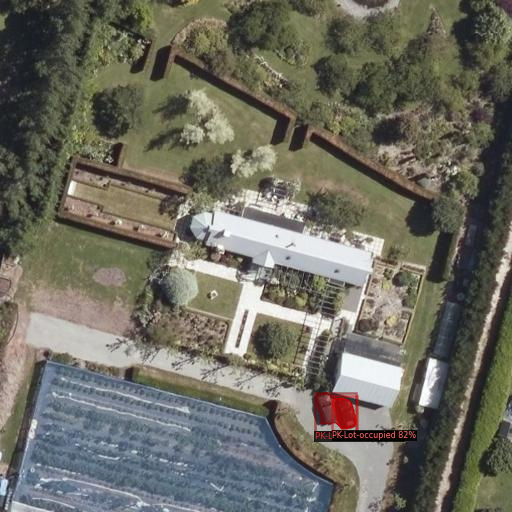

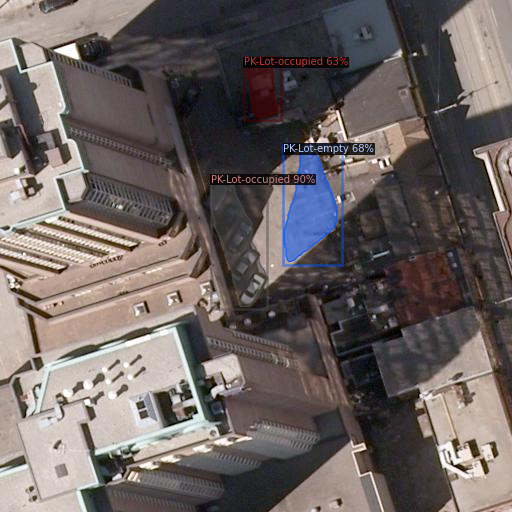

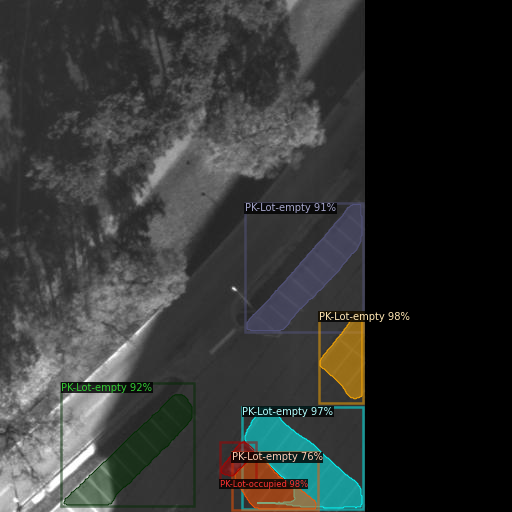

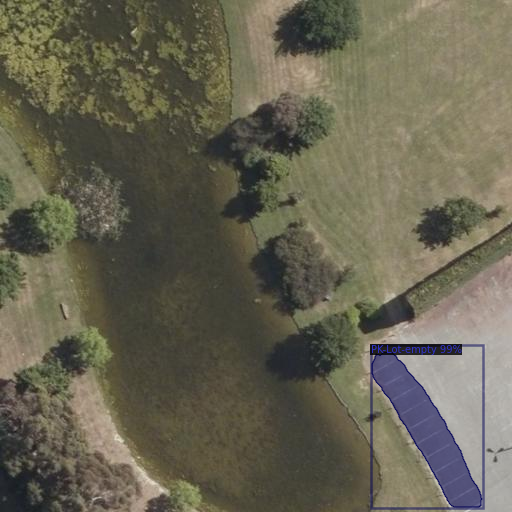

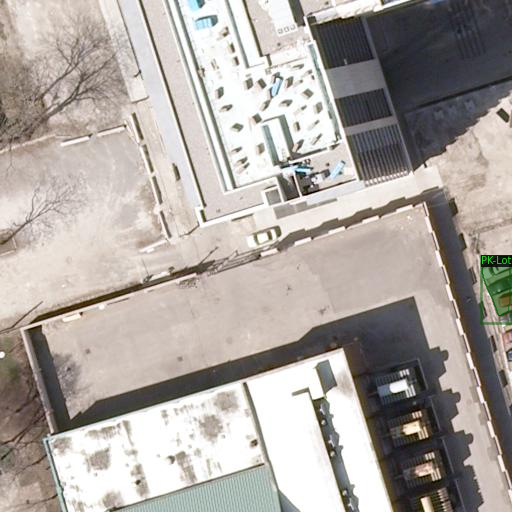

...

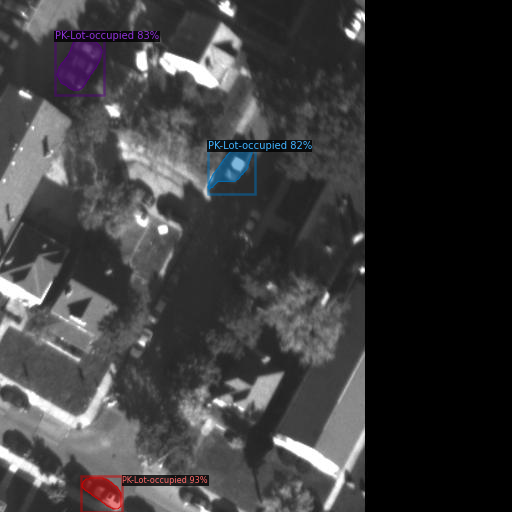

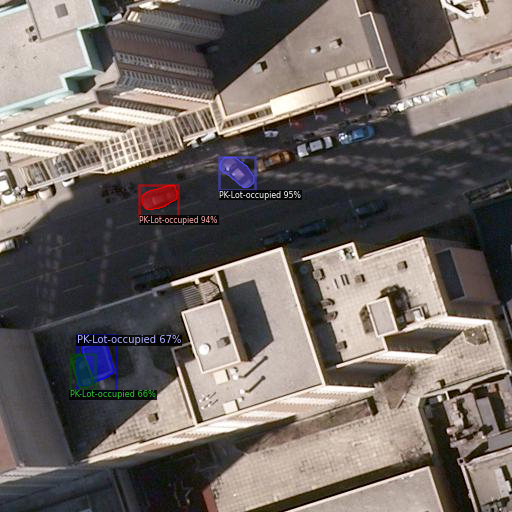

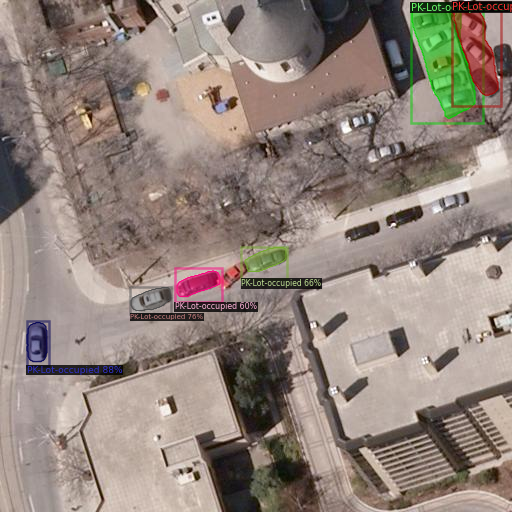

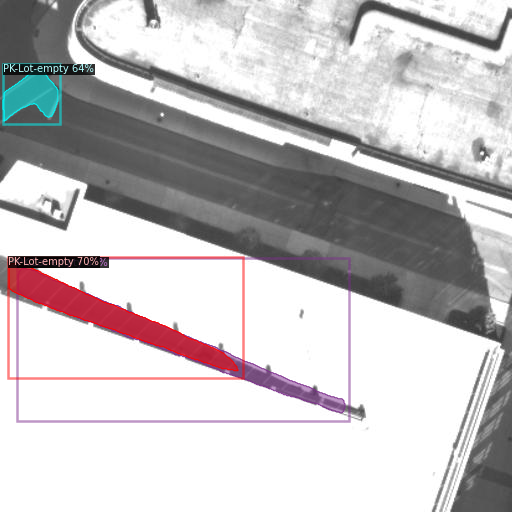

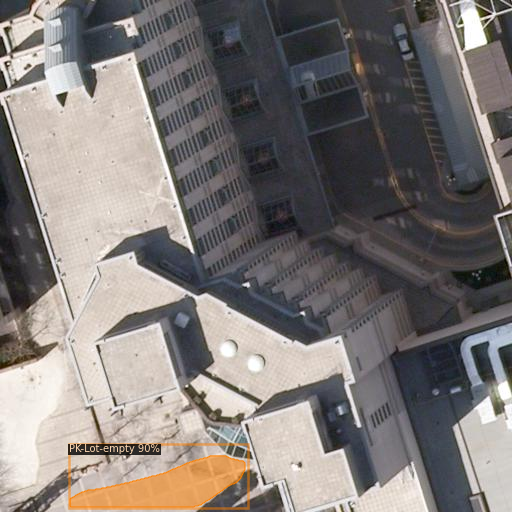

In [15]:

from detectron2.utils.visualizer import ColorMode
dataset_dicts = DatasetCatalog.get("my_dataset_test")
for d in random.sample(dataset_dicts, 20):    
    im = cv2.imread(d["file_name"])
    outputs = predictor(im)
    v = Visualizer(im[:, :, ::-1],
                   metadata=test_metadata, 
                   scale=1, 
                   #instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels
    )
    v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(v.get_image()[:, :, ::-1])

In [16]:
# from detectron2.utils.visualizer import ColorMode
import glob
#for imageName in glob.glob('/content/drive/MyDrive/Cowc for detectrone2 test/test/*.jpg'):
for d in dataset_dicts:
  im = cv2.imread(d["file_name"])
  outputs = predictor(im)
  break
  #print(outputnump)
  #print(outputs["panoptic_seg"])
  # f = open("/content/drive/MyDrive/Cowc for detectrone2 test/COWC_PKLot_Predictions.txt","a")
  # f.write(str(d["file_name"]) +"\n" + str(outputs["instances"])+"\n")
  # f.close()

In [17]:
type(outputs)

dict

In [18]:
try:
    import cPickle as pickle
except ImportError:  # Python 3.x
    import pickle

with open('data_pp.p', 'wb') as fp:
    pickle.dump(outputs, fp, protocol=pickle.HIGHEST_PROTOCOL)


/usr/local/lib/python3.7/dist-packages/torch/storage.py:34: FutureWarning: pickle support for Storage will be removed in 1.5. Use `torch.save` instead
  warnings.warn("pickle support for Storage will be removed in 1.5. Use `torch.save` instead", FutureWarning)


In [19]:
with open('data_pp.p', 'rb') as fp:
    data_pp = pickle.load(fp)

In [20]:
type(data_pp['instances'])

detectron2.structures.instances.Instances

In [21]:
data_pp

{'instances': Instances(num_instances=30, image_height=512, image_width=512, fields=[pred_boxes: Boxes(tensor([[272.5255, 389.2782, 334.7589, 451.3909],
         [ 34.6133, 394.2391,  60.8539, 438.4483],
         [115.2314, 480.8922, 210.2197, 510.8354],
         [304.8626, 165.0787, 333.2780, 206.1634],
         [195.6052, 480.0589, 224.5645, 512.0000],
         [129.4322, 312.1736, 276.2314, 402.2466],
         [103.7025, 370.8383, 132.6468, 414.4957],
         [100.5106, 411.8417, 256.9152, 504.5356],
         [226.9704, 465.6185, 255.2473, 506.2253],
         [249.9220, 414.8842, 282.6060, 464.8710],
         [ 57.3321, 374.0176, 113.4589, 428.4494],
         [385.0605, 260.5778, 463.3047, 323.2639],
         [287.0060, 450.4440, 314.3709, 493.1750],
         [269.4050, 307.8082, 296.8349, 349.3499],
         [351.5461, 423.3084, 401.6573, 485.0456],
         [111.8118, 170.6529, 152.0155, 201.0313],
         [353.3736, 378.4263, 390.3441, 431.2491],
         [337.8439, 385.9850, 3